In [1]:
import os
import numpy as np

In [2]:
os.chdir('D:\\idea projects\\pycharm projects\\ature\\')
from commons.IMAGE import Image
from commons.ImgLATTICE import Lattice
import preprocess.av.image_filters as fil
import cv2 as ocv

In [3]:
import preprocess.av.av_utils as av


In [4]:
img = Image('wide_image_03.mat')
img.apply_bilateral(img.img_array[:, :, 1])

[Log] Loading file ### wide_image_03.mat
Logging
[Log] Applying Bilateral filter.
[Log] ------[ RUNNING Time: 0.45859479904174805 seconds ]------


In [5]:
dif_bilateral = img.get_signed_diff_int8(img.img_array[:,:,1],img.img_bilateral)

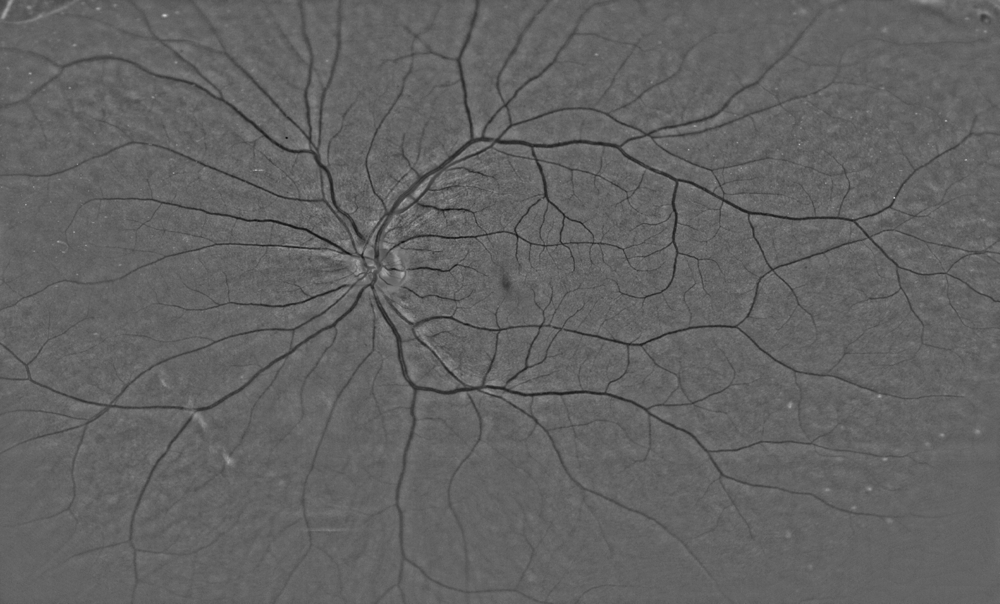

In [6]:
img.from_array(dif_bilateral)

[Log] Applying Gabor filter.
[Log] ------[ RUNNING Time: 4.154038190841675 seconds ]------


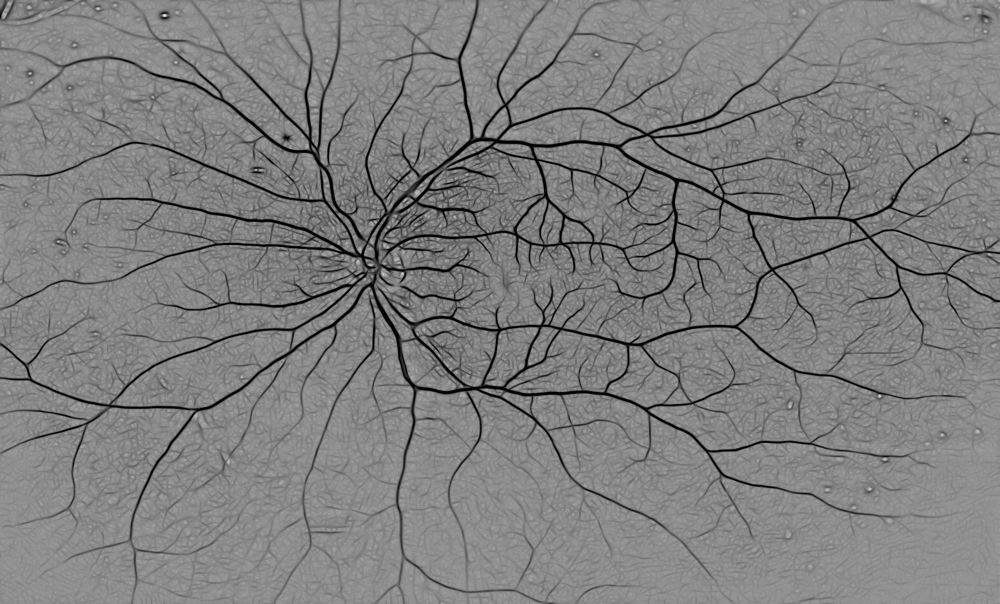

In [6]:
img.apply_gabor(255-dif_bilateral,filter_bank=fil.get_chosen_gabor_bank())
img.from_array(255-img.img_gabor)

In [7]:
img.create_skeleton_by_threshold(array_2d=img.img_gabor,threshold=5)

In [9]:
# img.img_skeleton[255-img.img_gabor]
# img.from_array(img.img_skeleton)

In [8]:
lattice = Lattice(image_2d=img.img_skeleton)

In [9]:
lattice.generate_lattice_graph()

[Log] Creating 4-connected lattice.
[Log] ------[ RUNNING Time: 35.29357719421387 seconds ]------


In [10]:
images =  [(0.25, img.img_array[:,:,1]),(0.25, img.img_bilateral), (0.5, img.img_gabor)]

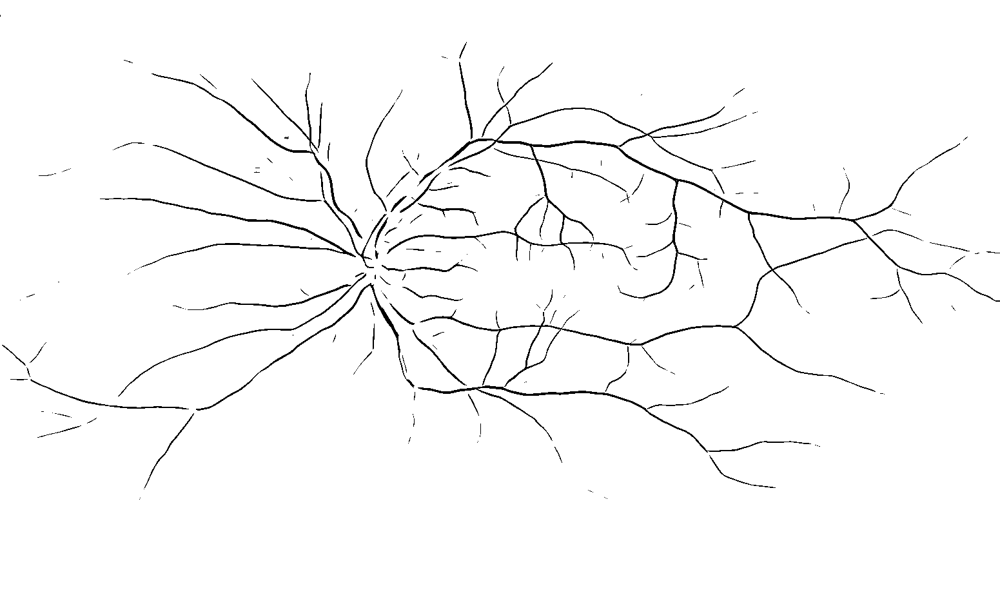

In [43]:
img.from_array(img.img_skeleton)

In [11]:
lattice.chunk_lattice(lattice.lattice, (3,5))

[Log] Chunking lattice to (3, 5) Lattices.
[Log] 0,0
[Log] 0,310
[Log] 0,620
[Log] 0,930
[Log] 0,1240
[Log] 312,0
[Log] 312,310
[Log] 312,620
[Log] 312,930
[Log] 312,1240
[Log] 624,0
[Log] 624,310
[Log] 624,620
[Log] 624,930
[Log] 624,1240
[Log] ------[ RUNNING Time: 7.924460172653198 seconds ]------


In [44]:
gp = lattice.k_lattices[6] 
res = lattice.get_lattice_portion(255-img.img_gabor, gp)

[Log] ------[ RUNNING Time: 0.03197312355041504 seconds ]------


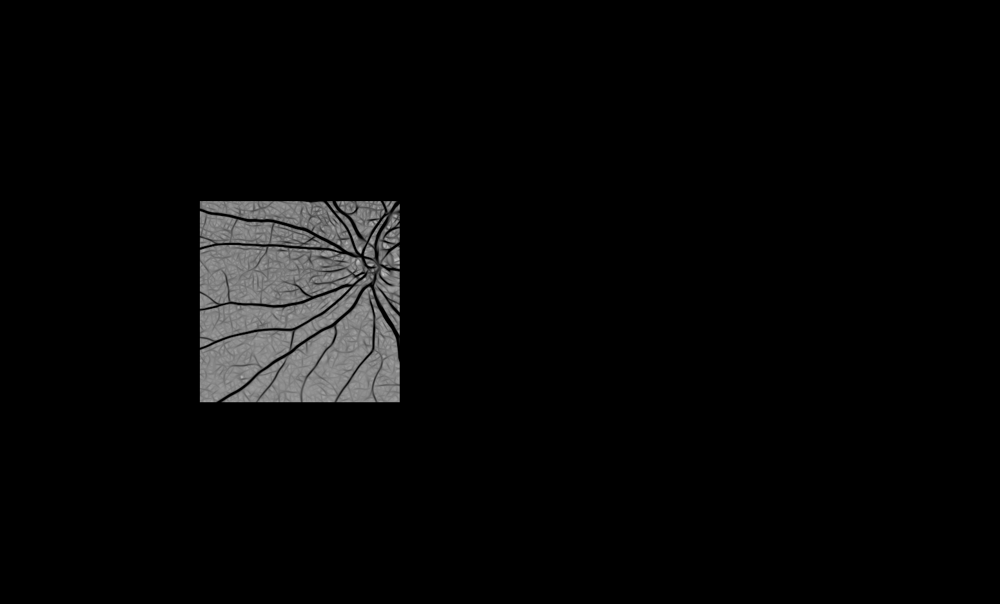

In [45]:
img.from_array(res)

# 

In [16]:
lattice.assign_node_metrics(graph=lattice.lattice,metrics=img.img_skeleton)

[Log] ------[ RUNNING Time: 1.1627905368804932 seconds ]------


In [17]:
lattice.assign_cost(lattice.lattice, images=images, alpha=15)

[Log] Calculating cost of moving to a neighbor.


3273: (2, 171)

5152: (3, 499)

7095: (4, 891)

9123: (5, 1368)

11085: (7, 228)

13328: (8, 920)

15156: (9, 1197)

16883: (10, 1373)

19094: (12, 482)

21196: (13, 1033)

23167: (14, 1453)

25241: (16, 425)

27177: (17, 810)

28852: (18, 934)

30845: (19, 1376)

32656: (21, 85)

33347: (21, 776)

35742: (23, 69)

37683: (24, 459)

39695: (25, 920)

41347: (26, 1021)

43117: (27, 1240)

45018: (29, 39)

46842: (30, 312)

48840: (31, 759)

50977: (32, 1345)

53310: (34, 576)

55295: (35, 1010)

57206: (36, 1370)

59171: (38, 233)

61070: (39, 581)

63330: (40, 1290)

65300: (42, 158)

67304: (43, 611)

69221: (44, 977)

71155: (45, 1360)

73227: (47, 330)

75273: (48, 825)

77327: (49, 1328)

79331: (51, 230)

81631: (52, 979)

83773: (54, 19)

85703: (55, 398)

87764: (56, 908)

89734: (57, 1327)

91789: (59, 280)

93710: (60, 650)

95739: (61, 1128)

97685: (62, 1523)

99745: (64, 481)

101695: (65, 880)

103667: (66, 1301)

105753: (68, 285)

107749: (69, 730)

109713: (70, 1143)

111652: (71, 1531)

113762: (73, 539)

115730: (74, 956)

117715: (75, 1390)

119689: (77, 262)

121762: (78, 784)

123684: (79, 1155)

125723: (81, 92)

127792: (82, 610)

129665: (83, 932)

131744: (84, 1460)

133633: (86, 247)

135787: (87, 850)

137751: (88, 1263)

139638: (90, 48)

141755: (91, 614)

143696: (92, 1004)

145415: (93, 1172)

147521: (95, 176)

149416: (96, 520)

151447: (97, 1000)

153509: (98, 1511)

155501: (100, 401)

157600: (101, 949)

159703: (102, 1501)

161808: (104, 504)

163818: (105, 963)

165892: (106, 1486)

168256: (108, 748)

170230: (109, 1171)

172216: (111, 55)

174252: (112, 540)

176250: (113, 987)

178244: (114, 1430)

180196: (116, 280)

180802: (116, 886)

182810: (117, 1343)

185082: (119, 513)

187210: (120, 1090)

189184: (121, 1513)

191138: (123, 365)

193155: (124, 831)

195183: (125, 1308)

197143: (127, 166)

199225: (128, 697)

201252: (129, 1173)

203264: (131, 83)

205226: (132, 494)

207107: (133, 824)

209109: (134, 1275)

211152: (136, 216)

213174: (137, 687)

215181: (138, 1143)

217199: (140, 59)

219294: (141, 603)

221302: (142, 1060)

223538: (144, 194)

225733: (145, 838)

227754: (146, 1308)

229737: (148, 189)

231709: (149, 610)

233730: (150, 1080)

235633: (151, 1432)

237638: (153, 335)

239684: (154, 830)

241694: (155, 1289)

243688: (157, 181)

245445: (158, 387)

247629: (159, 1020)

249669: (160, 1509)

251680: (162, 418)

253757: (163, 944)

255715: (164, 1351)

257663: (166, 197)

259634: (167, 617)

261593: (168, 1025)

263665: (169, 1546)

265676: (171, 455)

267753: (172, 981)

269705: (173, 1382)

271734: (175, 309)

273560: (176, 584)

275685: (177, 1158)

277730: (179, 101)

279609: (180, 429)

281663: (181, 932)

283651: (182, 1369)

285641: (184, 257)

287645: (185, 710)

289664: (186, 1178)

291700: (188, 112)

293652: (189, 513)

295682: (190, 992)

297737: (191, 1496)

299630: (193, 287)

301596: (194, 702)

303709: (195, 1264)

305687: (197, 140)

307711: (198, 613)

309664: (199, 1015)

311729: (200, 1529)

313716: (202, 414)

315673: (203, 820)

317681: (204, 1277)

319666: (206, 160)

321667: (207, 610)

323599: (208, 991)

325736: (210, 26)

327582: (211, 321)

329595: (212, 783)

331617: (213, 1254)

333627: (215, 162)

335723: (216, 707)

337589: (217, 1022)

339713: (219, 44)

341663: (220, 443)

343676: (221, 905)

345727: (222, 1405)

347656: (224, 232)

349617: (225, 642)

351721: (226, 1195)

353650: (228, 22)

355689: (229, 510)

357709: (230, 979)

359688: (231, 1407)

361656: (233, 273)

363597: (234, 663)

365605: (235, 1120)

367540: (236, 1504)

369662: (238, 524)

371710: (239, 1021)

373740: (240, 1500)

375620: (242, 278)

377570: (243, 677)

379590: (244, 1146)

381688: (246, 142)

383679: (247, 582)

385643: (248, 995)

387632: (249, 1433)

389750: (251, 449)

391759: (252, 907)

394047: (254, 93)

396148: (255, 643)

398168: (256, 1112)

400080: (257, 1473)

402149: (259, 440)

404137: (260, 877)

406142: (261, 1331)

408178: (263, 265)

410101: (264, 637)

412104: (265, 1089)

414122: (267, 5)

416103: (268, 435)

418117: (269, 898)

420044: (270, 1274)

421797: (271, 1476)

423847: (273, 424)

426105: (274, 1131)

428047: (275, 1522)

429997: (277, 370)

432189: (278, 1011)

434122: (279, 1393)

436080: (281, 249)

438143: (282, 761)

440053: (283, 1120)

441432: (284, 948)

443075: (285, 1040)

444509: (286, 923)

446246: (287, 1109)

448573: (289, 334)

450609: (290, 819)

452566: (291, 1225)

454502: (293, 59)

456613: (294, 619)

458661: (295, 1116)

460545: (296, 1449)

462630: (298, 432)

464509: (299, 760)

466641: (300, 1341)

468553: (302, 151)

470540: (303, 587)

472645: (304, 1141)

474609: (306, 3)

476553: (307, 396)

478661: (308, 953)

480613: (309, 1354)

482572: (311, 211)

484682: (312, 770)

486671: (313, 1208)

488603: (315, 38)

490563: (316, 447)

492707: (317, 1040)

494523: (318, 1305)

496621: (320, 301)

498656: (321, 785)

500576: (322, 1154)

502523: (323, 1550)

504688: (325, 613)

506599: (326, 973)

508674: (327, 1497)

510465: (329, 186)

512586: (330, 756)

514560: (331, 1179)

516518: (333, 35)

518606: (334, 572)

520608: (335, 1023)

522594: (336, 1458)

524576: (338, 338)

526553: (339, 764)

528581: (340, 1241)

530664: (342, 222)

532612: (343, 619)

534532: (344, 988)

536511: (345, 1416)

538670: (347, 473)

540692: (348, 944)

542529: (349, 1230)

544650: (351, 249)

546552: (352, 600)

548625: (353, 1122)

550546: (354, 1492)

552610: (356, 454)

554673: (357, 966)

556543: (358, 1285)

558626: (360, 266)

560564: (361, 653)

562558: (362, 1096)

564512: (363, 1499)

566574: (365, 459)

568567: (366, 901)

570662: (367, 1445)

572646: (369, 327)

574622: (370, 752)

576623: (371, 1202)

578543: (373, 20)

580654: (374, 580)

582624: (375, 999)

584636: (376, 1460)

586551: (378, 273)

588620: (379, 791)

590578: (380, 1198)

592514: (382, 32)

594627: (383, 594)

596632: (384, 1048)

598601: (385, 1466)

600565: (387, 328)

602516: (388, 728)

604518: (389, 1179)

606694: (391, 253)

608703: (392, 711)

610734: (393, 1191)

613145: (395, 500)

615034: (396, 838)

617020: (397, 1273)

619036: (399, 187)

621096: (400, 696)

621692: (400, 1292)

623459: (401, 1508)

625194: (403, 141)

627350: (404, 746)

629532: (405, 1377)

631529: (407, 272)

633658: (408, 850)

635624: (409, 1265)

637565: (411, 104)

639370: (412, 358)

641575: (413, 1012)

643659: (414, 1545)

645660: (416, 444)

647509: (417, 742)

649553: (418, 1235)

651640: (420, 220)

653600: (421, 629)

655555: (422, 1033)

657608: (423, 1535)

659607: (425, 432)

661582: (426, 856)

663491: (427, 1214)

665534: (429, 155)

667599: (430, 669)

669514: (431, 1033)

671634: (433, 51)

673600: (434, 466)

675586: (435, 901)

677600: (436, 1364)

679585: (438, 247)

681521: (439, 632)

683585: (440, 1145)

685446: (441, 1455)

687642: (443, 549)

689526: (444, 882)

691458: (445, 1263)

693545: (447, 248)

695581: (448, 733)

697505: (449, 1106)

699546: (451, 45)

701537: (452, 485)

703374: (453, 771)

705587: (454, 1433)

707535: (456, 279)

709525: (457, 718)

711456: (458, 1098)

713521: (460, 61)

715511: (461, 500)

717611: (462, 1049)

719550: (463, 1437)

721592: (465, 377)

723670: (466, 904)

725689: (467, 1372)

728005: (469, 586)

730017: (470, 1047)

732046: (471, 1525)

734163: (473, 540)

736165: (474, 991)

738196: (475, 1471)

740585: (477, 758)

742551: (478, 1173)

744614: (480, 134)

746558: (481, 527)

748579: (482, 997)

750629: (483, 1496)

752575: (485, 340)

754494: (486, 708)

756492: (487, 1155)

758601: (489, 162)

760607: (490, 617)

762620: (491, 1079)

764541: (492, 1449)

766494: (494, 300)

768546: (495, 801)

770442: (496, 1146)

772470: (498, 72)

774483: (499, 534)

776541: (500, 1041)

778461: (501, 1410)

780604: (503, 451)

782561: (504, 857)

784454: (505, 1199)

786553: (507, 196)

788484: (508, 576)

790496: (509, 1037)

792648: (511, 87)

794654: (512, 542)

796763: (513, 1100)

798998: (515, 233)

801006: (516, 690)

803007: (517, 1140)

804887: (518, 1469)

807014: (520, 494)

808979: (521, 908)

811005: (522, 1383)

813010: (524, 286)

814399: (525, 124)

816245: (526, 419)

818362: (527, 985)

820643: (529, 164)

822324: (530, 294)

823642: (531, 61)

825157: (532, 25)

827142: (533, 459)

828877: (534, 643)

830995: (535, 1210)

832999: (537, 112)

834977: (538, 539)

837071: (539, 1082)

839011: (540, 1471)

841070: (542, 428)

843075: (543, 882)

845052: (544, 1308)

846981: (546, 135)

848957: (547, 560)

851069: (548, 1121)

853020: (549, 1521)

855099: (551, 498)

857063: (552, 911)

858952: (553, 1249)

861025: (555, 220)

862996: (556, 640)

864968: (557, 1061)

866905: (558, 1447)

869002: (560, 442)

870986: (561, 875)

872958: (562, 1296)

874968: (564, 204)

877094: (565, 779)

879088: (566, 1222)

881005: (568, 37)

882974: (569, 455)

884954: (570, 884)

886917: (571, 1296)

888925: (573, 202)

891079: (574, 805)

893035: (575, 1210)

895061: (577, 134)

897040: (578, 562)

899004: (579, 975)

900938: (580, 1358)

902992: (582, 310)

904962: (583, 729)

906951: (584, 1167)

908973: (586, 87)

910955: (587, 518)

912960: (588, 972)

914977: (589, 1438)

915619: (590, 529)

917634: (591, 993)

920023: (593, 280)

921984: (594, 690)

923961: (595, 1116)

925922: (596, 1526)

928035: (598, 537)

930013: (599, 964)

932062: (600, 1462)

934070: (602, 368)

936019: (603, 766)

938019: (604, 1215)

939923: (606, 17)

941889: (607, 432)

944028: (608, 1020)

946014: (609, 1455)

948016: (611, 355)

949971: (612, 759)

951948: (613, 1185)

953897: (615, 32)

955924: (616, 508)

958050: (617, 1083)

960077: (619, 8)

961937: (620, 317)

964017: (621, 846)

966055: (622, 1333)

967895: (624, 71)

970051: (625, 676)

971922: (626, 996)

973996: (627, 1519)

975974: (629, 395)

977910: (630, 780)

979976: (631, 1295)

981988: (633, 205)

984046: (634, 712)

986012: (635, 1127)

987972: (636, 1536)

990065: (638, 527)

992032: (639, 943)

994012: (640, 1372)

996068: (642, 326)

998048: (643, 755)

1000061: (644, 1217)

1001991: (646, 45)

1004003: (647, 506)

1005962: (648, 914)

1008042: (649, 1443)

1009993: (651, 292)

1011980: (652, 728)

1013952: (653, 1149)

1016005: (655, 100)

1018063: (656, 607)

1020025: (657, 1018)

1021963: (658, 1405)

1023975: (660, 315)

1025924: (661, 713)

1028060: (662, 1298)

1029899: (664, 35)

1032089: (665, 674)

1034185: (666, 1219)

1036419: (668, 351)

1038535: (669, 916)

1040532: (670, 1362)

1042499: (672, 227)

1044429: (673, 606)

1046471: (674, 1097)

1048528: (676, 52)

1050444: (677, 417)

1052460: (678, 882)

1054440: (679, 1311)

1056397: (681, 166)

1058388: (682, 606)

1060486: (683, 1153)

1062468: (685, 33)

1064478: (686, 492)

1066505: (687, 968)

1068556: (688, 1468)

1070579: (690, 389)

1072577: (691, 836)

1074587: (692, 1295)

1076735: (694, 341)

1079044: (695, 1099)

1080879: (696, 1383)

1082918: (698, 320)

1084939: (699, 790)

1086894: (700, 1194)

1088997: (702, 195)

1090927: (703, 574)

1092910: (704, 1006)

1094910: (705, 1455)

1096918: (707, 361)

1098918: (708, 810)

1100911: (709, 1252)

1102891: (711, 130)

1104981: (712, 669)

1106982: (713, 1119)

1108957: (714, 1543)

1111069: (716, 553)

1113069: (717, 1002)

1115096: (718, 1478)

1117421: (720, 701)

1119439: (721, 1168)

1121525: (723, 152)

1123494: (724, 570)

1125535: (725, 1060)

1127508: (726, 1482)

1129535: (728, 407)

1131510: (729, 831)

1133497: (730, 1267)

1135460: (732, 128)

1137382: (733, 499)

1139426: (734, 992)

1141378: (735, 1393)

1143485: (737, 398)

1145401: (738, 763)

1147391: (739, 1202)

1149488: (741, 197)

1151351: (742, 509)

1153497: (743, 1104)

1155475: (744, 1531)

1157339: (746, 293)

1159376: (747, 779)

1161506: (748, 1358)

1163447: (750, 197)

1165362: (751, 561)

1167468: (752, 1116)

1169557: (754, 103)

1171558: (755, 553)

1173791: (756, 1235)

1175941: (758, 283)

1177994: (759, 785)

1179998: (760, 1238)

1181908: (762, 46)

1183977: (763, 564)

1185962: (764, 998)

1187978: (765, 1463)

1189929: (767, 312)

1191845: (768, 677)

1194000: (769, 1281)

1196047: (771, 226)

1198048: (772, 676)

1200163: (773, 1240)

1202466: (775, 441)

1204430: (776, 854)

1206335: (777, 1208)

1208456: (779, 227)

1209550: (779, 1321)

1211549: (781, 218)

1213602: (782, 720)

1215880: (783, 1447)

1217837: (785, 302)

1219845: (786, 759)

1221864: (787, 1227)

1223905: (789, 166)

1225878: (790, 588)

1227940: (791, 1099)

1229908: (792, 1516)

1231881: (794, 387)

1233858: (795, 813)

1235846: (796, 1250)

1237868: (798, 170)

1239869: (799, 620)

1241822: (800, 1022)

1243804: (801, 1453)

1245830: (803, 377)

1247834: (804, 830)

1249861: (805, 1306)

1251869: (807, 212)

1253850: (808, 642)

1255777: (809, 1018)

1257798: (810, 1488)

1259920: (812, 508)

1261871: (813, 908)

1263716: (814, 1202)

1265856: (816, 240)

1267817: (817, 650)

1269825: (818, 1107)

1271845: (820, 25)

1273934: (821, 563)

1275836: (822, 914)

1277850: (823, 1377)

1279665: (825, 90)

1281863: (826, 737)

1283835: (827, 1158)

1285995: (829, 216)

1287974: (830, 644)

1289862: (831, 981)

1292023: (833, 40)

1294031: (834, 497)

1296198: (835, 1113)

1298371: (837, 184)

1300417: (838, 679)

1302426: (839, 1137)

1304490: (841, 99)

1306369: (842, 427)

1308459: (843, 966)

1310353: (844, 1309)

1312473: (846, 327)

1314437: (847, 740)

1316360: (848, 1112)

1318462: (850, 112)

1320432: (851, 531)

1322447: (852, 995)

1324387: (853, 1384)

1326339: (855, 234)

1328394: (856, 738)

1330349: (857, 1142)

1332499: (859, 190)

1334355: (860, 495)

1336327: (861, 916)

1338417: (862, 1455)

1340350: (864, 286)

1342477: (865, 862)

1344425: (866, 1259)

1346365: (868, 97)

1348356: (869, 537)

1350428: (870, 1058)

1352384: (871, 1463)

1354372: (873, 349)

1356408: (874, 834)

1358347: (875, 1222)

1360423: (877, 196)

1362495: (878, 717)

1364374: (879, 1045)

1366389: (880, 1509)

1367943: (881, 1512)

1369563: (883, 30)

1371313: (884, 229)

1372784: (885, 149)

1374505: (886, 319)

1376013: (887, 276)

1377999: (888, 711)

1379587: (889, 748)

1381505: (890, 1115)

1383337: (891, 1396)

1385029: (892, 1537)

1387257: (894, 663)

1389003: (895, 858)

1390287: (896, 591)

1392006: (897, 759)

1393953: (898, 1155)

1395913: (900, 13)

1397790: (901, 339)

1399882: (902, 880)

1401884: (903, 1331)

1403880: (905, 225)

1405835: (906, 629)

1407556: (907, 799)

1409950: (909, 91)

1411912: (910, 502)

1413855: (911, 894)

1415799: (912, 1287)

1417933: (914, 319)

1419842: (915, 677)

1421848: (916, 1132)

1423890: (918, 72)

1425896: (919, 527)

1427960: (920, 1040)

1429966: (921, 1495)

1431918: (923, 345)

1433866: (924, 742)

1435972: (925, 1297)

1437972: (927, 195)

1439921: (928, 593)

1441895: (929, 1016)

1443858: (930, 1428)

1445808: (932, 276)

1447866: (933, 783)

1449828: (934, 1194)

1451869: (936, 133)

1453286: (936, 1550)[Log] ------[ RUNNING Time: 231.31430006027222 seconds ]------


In [18]:
lattice.assign_cost(lattice.k_lattices[6], images=images, alpha=15)

[Log] Calculating cost of moving to a neighbor.


3819: (324, 409)

6320: (332, 430)

8685: (340, 315)

11010: (347, 470)

13243: (354, 533)

15756: (362, 566)

18271: (370, 601)

20185: (377, 345)

22196: (383, 496)

24749: (391, 569)

27214: (399, 554)

29888: (408, 438)

32196: (415, 576)

34229: (422, 439)

36876: (430, 606)

39241: (438, 491)

41833: (446, 603)

44406: (455, 386)

46736: (462, 546)

49360: (471, 380)

51808: (479, 348)

54379: (487, 439)

56317: (493, 517)

58517: (500, 547)

60771: (508, 321)

63193: (515, 573)

65720: (524, 310)

68317: (532, 427)

70771: (540, 401)

73267: (548, 417)

75802: (556, 472)

78234: (564, 424)

80717: (572, 427)

83229: (580, 459)

85820: (588, 570)

88013: (595, 593)

89761: (601, 481)

92203: (609, 443)

94666: (617, 426)

96558: (623, 458)

96719: (623, 619)[Log] ------[ RUNNING Time: 14.683366775512695 seconds ]------


In [20]:
can = lattice.k_lattices[6]

In [23]:
can[(312, 314)]

{(312, 313): {'cost': 2.1877744248221838,
  'i_diff_1': 4.0,
  'i_diff_2': 0.0,
  'i_diff_3': 20.0},
 (312, 315): {'cost': 1.4701045966532127,
  'i_diff_1': 1.0,
  'i_diff_2': 0.0,
  'i_diff_3': 11.0},
 (313, 314): {'cost': 1.096614244672777,
  'i_diff_1': 4.0,
  'i_diff_2': 0.0,
  'i_diff_3': 1.0}}

In [24]:
lattice.lattice[(312, 314)]

{(311, 314): {'cost': 1.3641136306802348,
  'i_diff_1': 1.0,
  'i_diff_2': 0.0,
  'i_diff_3': 9.0},
 (312, 313): {'cost': 2.1877744248221838,
  'i_diff_1': 4.0,
  'i_diff_2': 0.0,
  'i_diff_3': 20.0},
 (312, 315): {'cost': 1.4701045966532127,
  'i_diff_1': 1.0,
  'i_diff_2': 0.0,
  'i_diff_3': 11.0},
 (313, 314): {'cost': 1.096614244672777,
  'i_diff_1': 4.0,
  'i_diff_2': 0.0,
  'i_diff_3': 1.0},
 'skeleton': 255}

In [1]:
import networkx as nx

In [1]:
# prims = nx.algorithms.prim_mst(g,weight='cost')

In [15]:
g[(69,721)]

{(68, 721): {'cost': 1.1326404277198234,
  'i_diff_1': 0.0,
  'i_diff_2': 0.0,
  'i_diff_3': 4.0},
 (69, 720): {'cost': 2.077075464013664,
  'i_diff_1': 3.0,
  'i_diff_2': 0.0,
  'i_diff_3': 19.0},
 (69, 722): {'cost': 1.031211759115756,
  'i_diff_1': 2.0,
  'i_diff_2': 0.0,
  'i_diff_3': 0.0},
 (70, 721): {'cost': 1.0, 'i_diff_1': 0.0, 'i_diff_2': 0.0, 'i_diff_3': 0.0},
 'skeleton': 0}